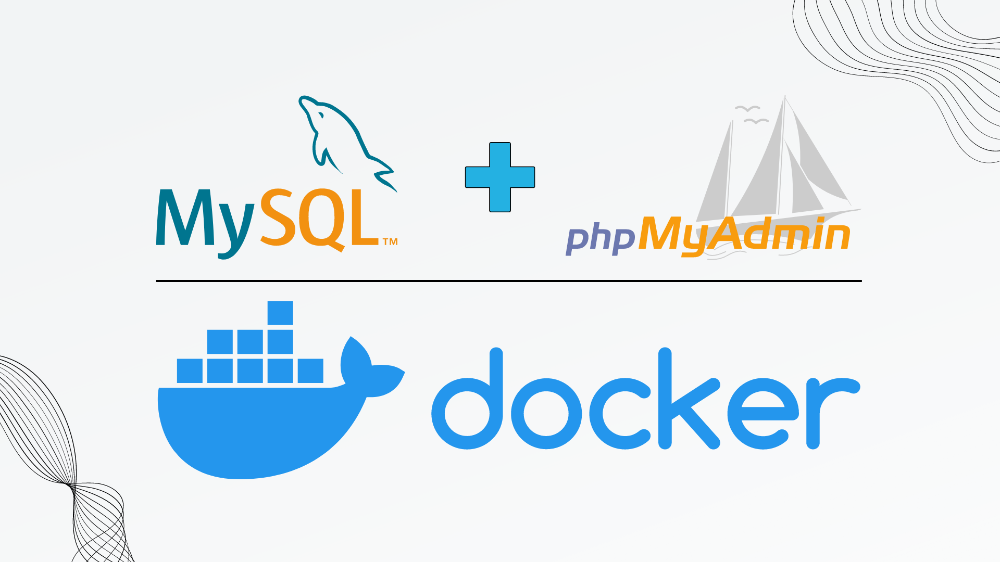

[Previously](https://andrewyewcy.com/Systematically-Web-Scrape-Multiple-Data-Files-from-Websites/), the bicycle ride data from Bixi was web-sraped and stored locally. In this article, we explore how to store the data inside a relational database using MySQL, phpMyAdmin, and Docker containers. 

# Motivation and Introduction

## Why store the data in a database?

**Consolidation**
- The web-scraped data is stored across multiple Comma Separated Value (CSV) files, which makes it more difficult to access all the data since the data files must be loaded individually from each CSV and combined before use.


**Tracking**
- With change being the only constant, no data is expected to be perfect or clean. Using a database with a database management system (DBMS) like MySQL allows for logging and tracking of updates to data.


**Structure, Relationships and Normalization**
- On top of being a DBMS, MySQL is also a relational DBMS, meaning that different data tables can be connected through specified relationships between columns. For example, a bicycle docking station can store many bicycles. Furthermore, large data tables (many columns) can be broken down into smaller tables which are connected through relationships. This is known as normalization and the benefits include smaller data tables and data completenss.


**Sharing, Authority and Security**
- Rather than sending the data files through email, other users can access the same consolidated data stored in a database. This reduces the risks of having multiple copies (truths) of data among users, which causes confusion and may lead to wasted time or even wrongly justified decision making. Finally, MySQL also provides a way to manage access levels to data among users.

## What are the tools and why?

**[MySQL](https://www.mysql.com/)**
- MySQL is an open-source relational database management system. It allows for the creation and storage of databases, along with the relationships between the stored data tables. Although not the latest, it is one of the world's most [popular](https://hub.docker.com/_/mysql) DBMS.

**[phpMyAdmin](https://www.phpmyadmin.net/)**
- Without a user interface, MySQL can only be interacted with through Terminal (or PowerShell and Command Prompt depending on OS). phpMyAdmin addresses this problem by being an open-source portable web application that acts as an administration tool for MySQL.

**[Docker](https://www.docker.com/)**
- Docker is a tool that packages software into containers independent of the local system. Docker was used to setup MySQL and phpMyAdmin on the local computer, and can be used to package the entire setup in the future.

## Wait, isn't Docker for Software Development?

The ability to containerize applications provided by Docker is useful in the field of data science in the following manner:

**Ease of Installation**
- Using Docker containers avoids the need to install MySQL and all its dependencies on your local computer. Instead of spending hours installing and configuring MySQL to work with phpMyAdmin over many computers, using Docker containers allows users to get MySQL running with phpMyAdmin in less than 5 minutes consistently across many computers.

**Sharing and Scaling**
- In the world of big data, the data size is usually too large to store in any single computer. Docker containers allow users to transition their containerized DBMS and volumes onto the cloud, skipping the hassle of reconfiguring setup to match cloud specifications.

**Operations and Modularization**
- Containerized applications can be easily updated or replaced with another container if the current one fails. This means that the entire operations process of DBMS deployment can modularized into components. Individual components (containers) can be replaced without affecting operations, meaning that the database downtime is reduced to a minimum.

# Overview of Setup

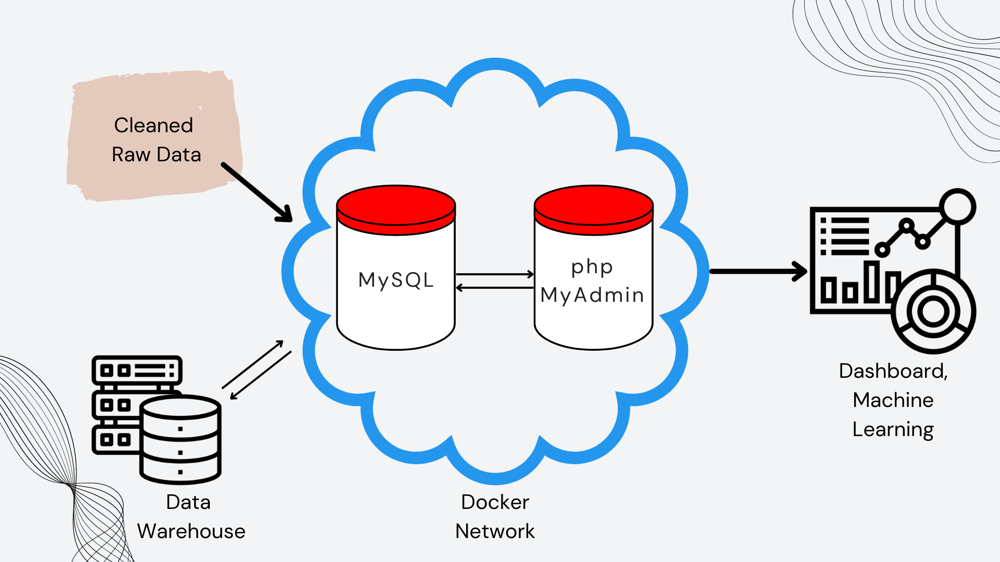

The containers with red caps represent Docker containers running MySQL and phpMyAdmin Docker images. Both the MySQL and phpMyAdmin containers can communicate with each other because they exist in a Docker network, represented by the cloud. The actual data is stored outside the cloud in a data warehouse, which in this case is just the local computer. Note that in the data warehouse, data is stored as Docker volumes, which can be pushed and scaled on cloud services like AWS. The cleaned raw data is ingested through MySQL and stored in the data warehouse. Finally, dashboards and machine learning can access the data through MySQL in the Docker network.

# Requirements

To run the above setup, you will need:
- Docker [installed](https://docs.docker.com/get-docker/) on your local computer
- a web browser, Google Chrome was used in this article
- (optional) a code editor for writing Docker-Compose script, [VSCodium](https://vscodium.com/) was used

# Deployment of DBMS Setup using Docker Compose

The first step is to create a docker-compose script that tells Docker what containers to setup. Docker-compose automatically handles the creation of the network. The script is written as a [YAML](https://en.wikipedia.org/wiki/YAML) file, which is a human readable data serialization language. A GitHub repo for the script can be found [here](https://github.com/andrewyewcy/docker/blob/main/mysql.yaml)

In [ ]:
# Copy and paste below script into a code-editor of your choice, then save as a YAML file
# Specify version of docker-compose for backwards compatability
version: '3.8'

# Define services (docker containers) to run
services:
  
  # Define a container named mysql to run MySQL DBMS
  mysql:

    # Specify image tag to reference, refer to Docker Hub https://hub.docker.com/_/mysql
    image: mysql:8.0

    # Tells Docker to restart container if fail
    restart: always

    # Define environment variables, different for each image
    environment:
      # rootroot was used in this case as an example
      MYSQL_ROOT_PASSWORD: rootroot

    # Define ports for communication between host (left) and container(right)
    ports:
      - '3306:3306'

    # Define volumne to write data to for data persistence when container restarts
    # Local host directory (left) : directory in container (right)
    volumes:
      - mysql_db_data:/var/lib/mysql

  # Define a container to run phpMyAdmin
  phpmyadmin:

    # Specify image tag to reference, refer to Docker Hub https://hub.docker.com/_/phpmyadmin
    image: phpmyadmin:5.2

    # Tells Docker to restart container if fail
    restart: always

    # Define ports for communication between host (left) and container(right)
    ports:
      - '8080:80'

    # Define link from mysql container to phpmyadmin container
    links:
      - mysql:db

# Define Docker volumes to store data
volumes:

  # Specify volume name
  mysql_db_data:

    # Tells docker that volume is stored on local computer
    driver: local

The beauty of using Docker is that the entire setup above can be executed in 1 line of code using docker-compose provided the docker-compose script (yaml file) is setup correctly:

In [ ]:
# Run below line in terminal, make sure you are in same directory as YAML file
docker-compose -f mysql.yaml up

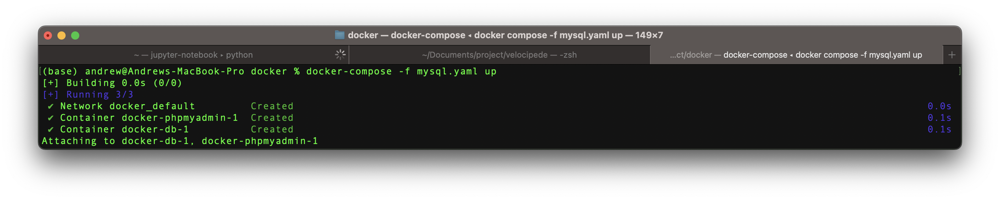

Once the docker network and containers are up and running, type the following path into a web browser of your choice to access phpMyAdmin.

In [ ]:
# Note, the port 8080 was specified in the yaml file
http://localhost:8080/

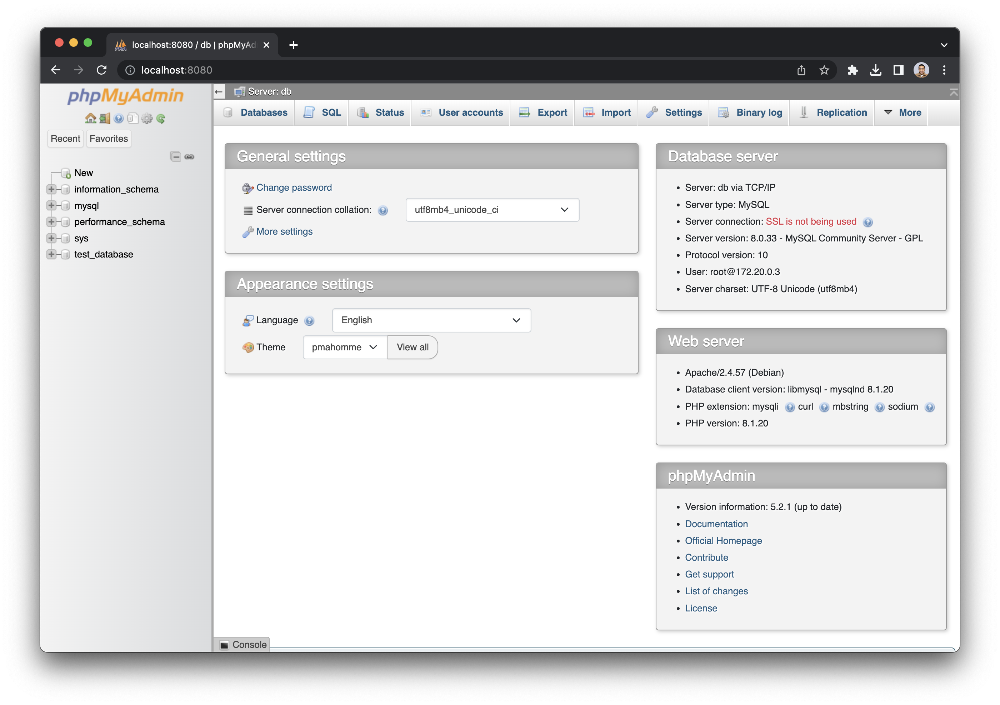

# Pull Images from Docker Hub

- [MySQL](https://hub.docker.com/_/mysql)
- [phpMyAdmin](https://hub.docker.com/_/phpmyadmin)

Ensure docker is running

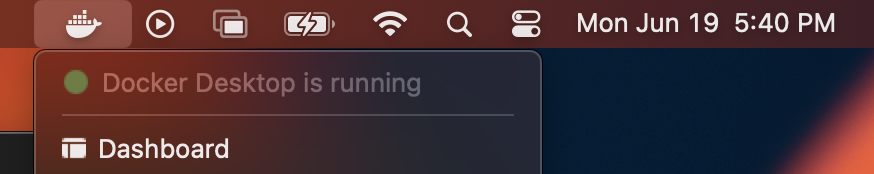

Alternatively, use `docker` version command for verification.

- docker client
- docker desktop

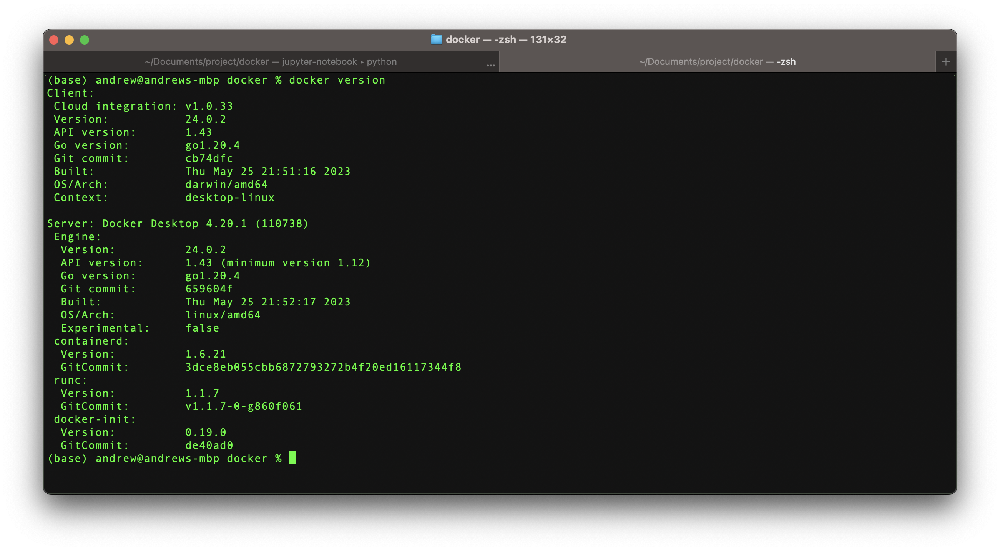

Check existing images

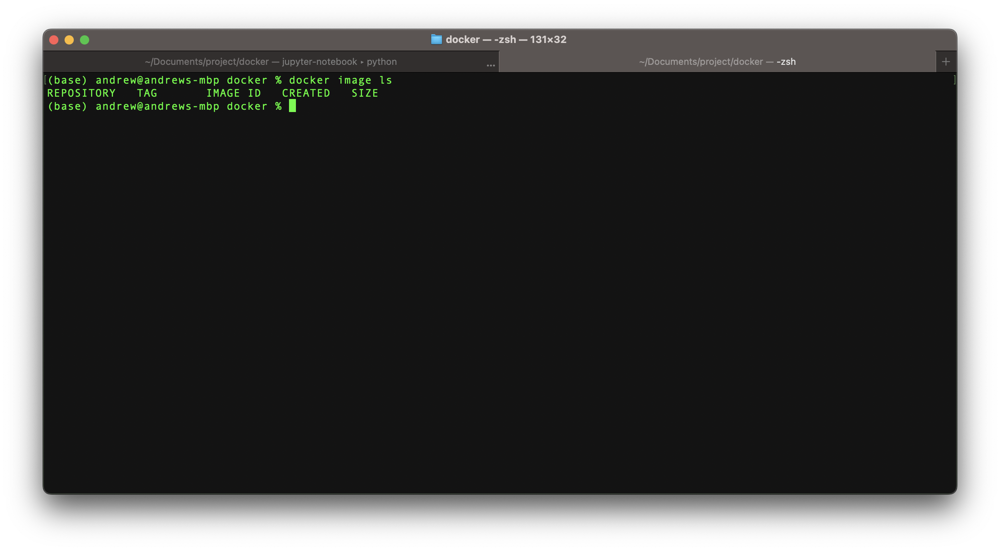

Pull images
- mySQL version 8.0
- phpmyadmin 5.2

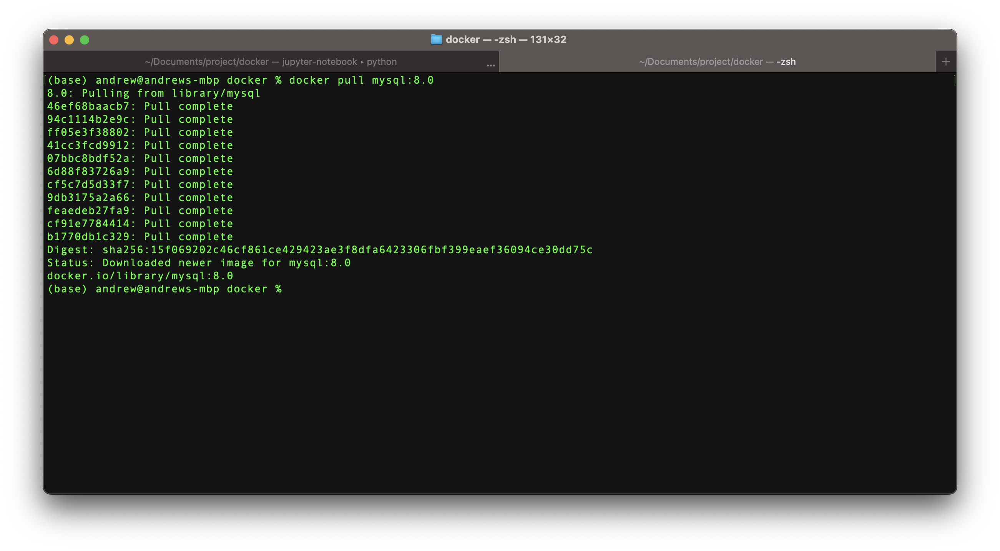

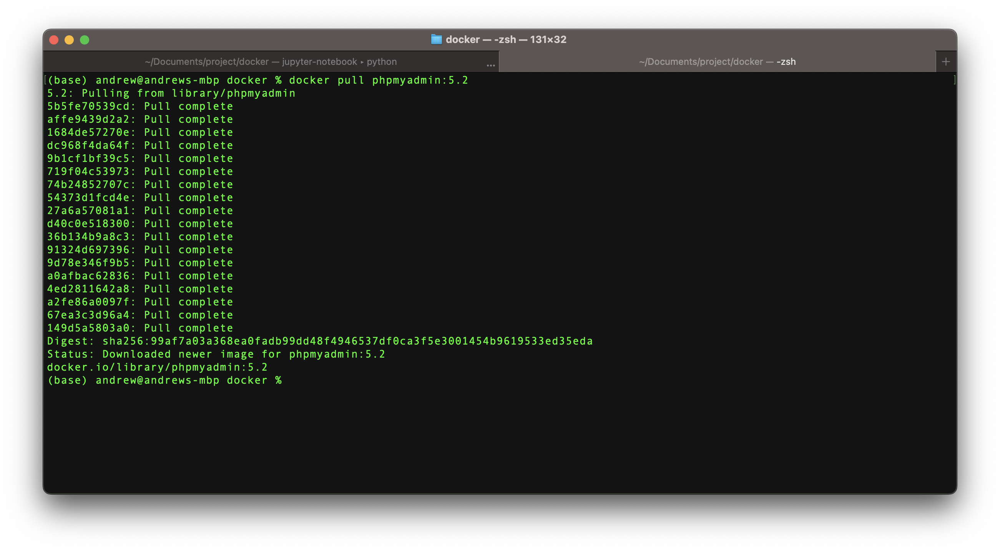

Check if images are pulled:

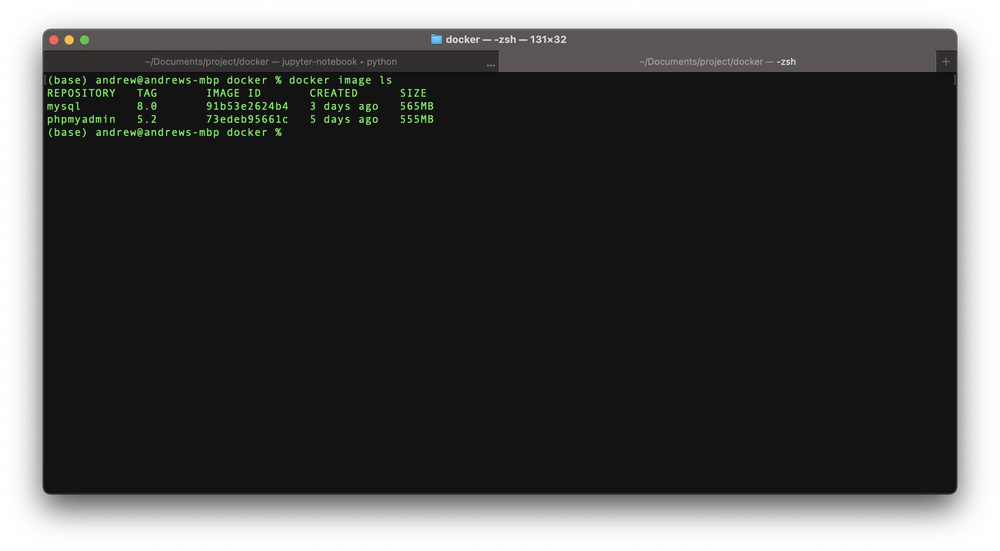

# Creating a Network to run Containers

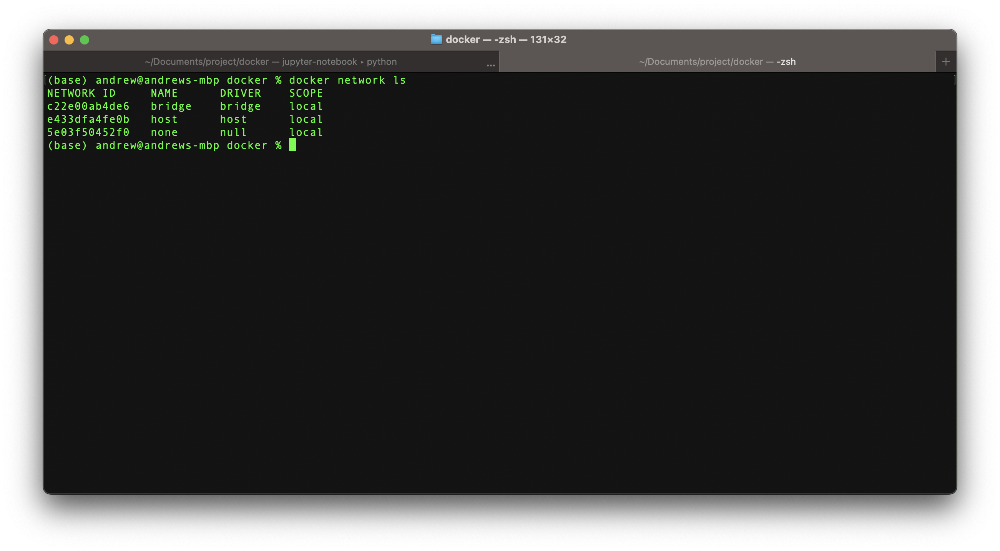

Create the network to host mysql and phpmyadmin containers

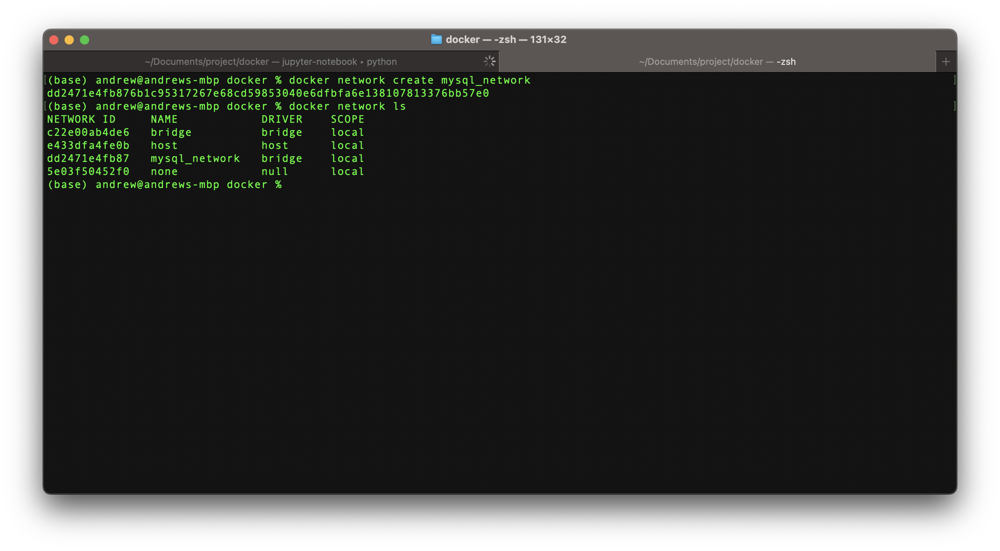

# Create a Container Running MySQL from image in Network

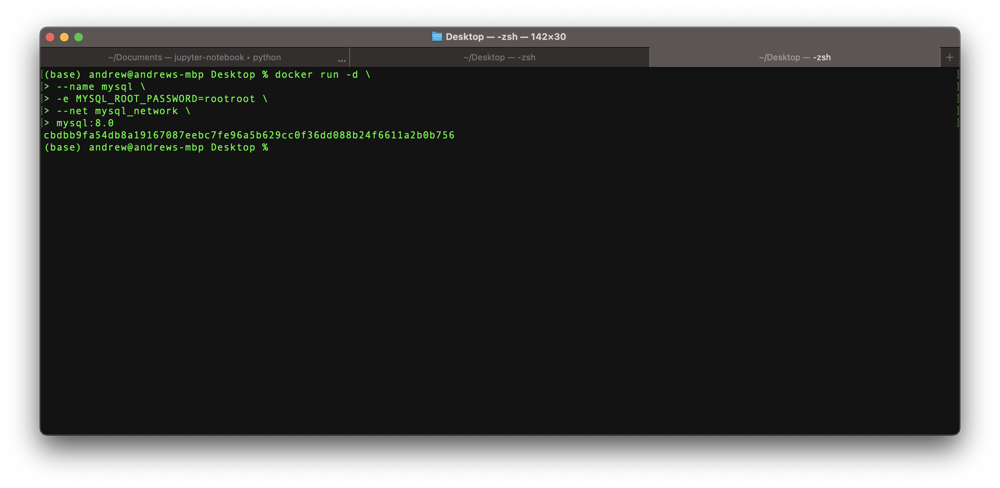

Check if container is created and running

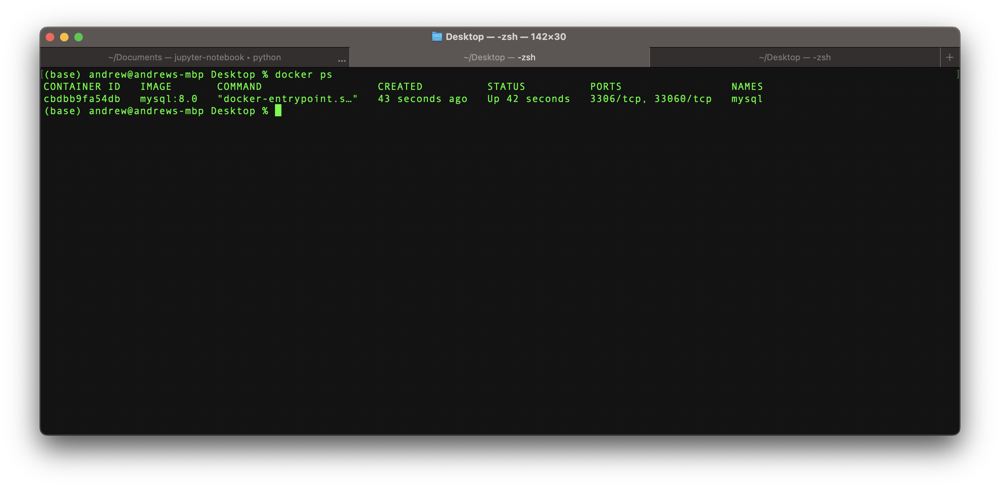

Verify version of mySQL by entering into terminal within container.

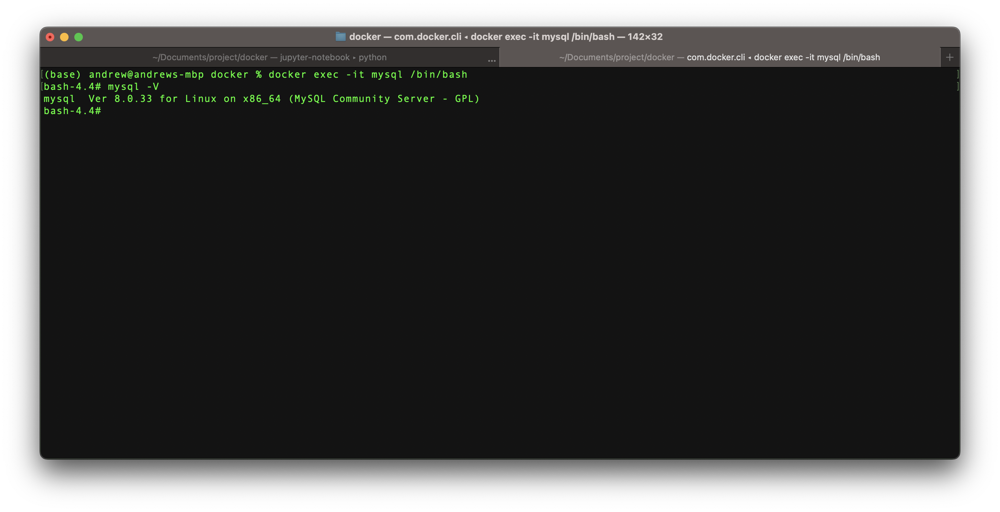

# In same network, create phpmyadmin linked to mysql container

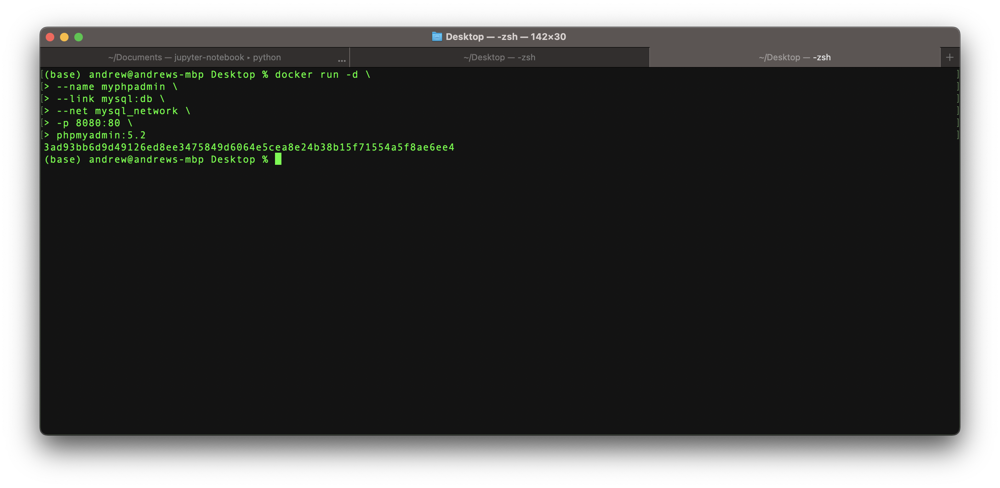

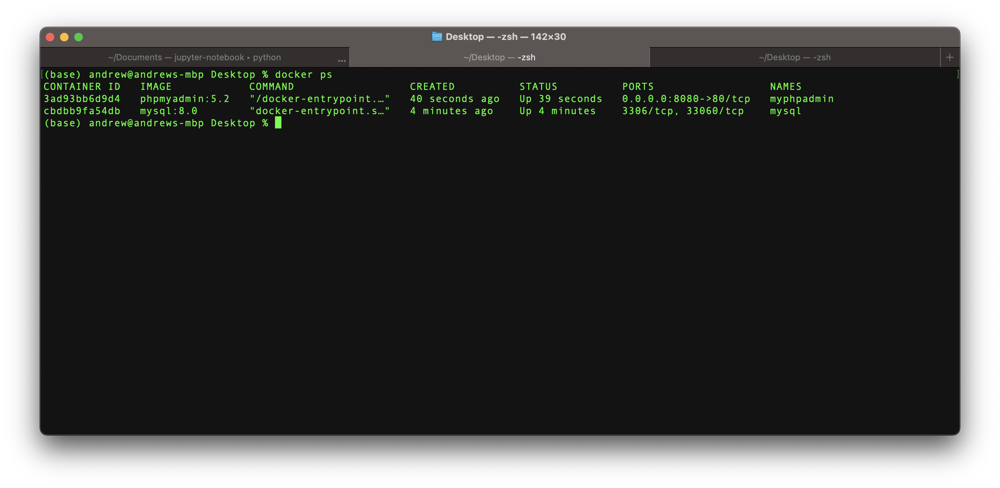

Check that myphpadmin is running

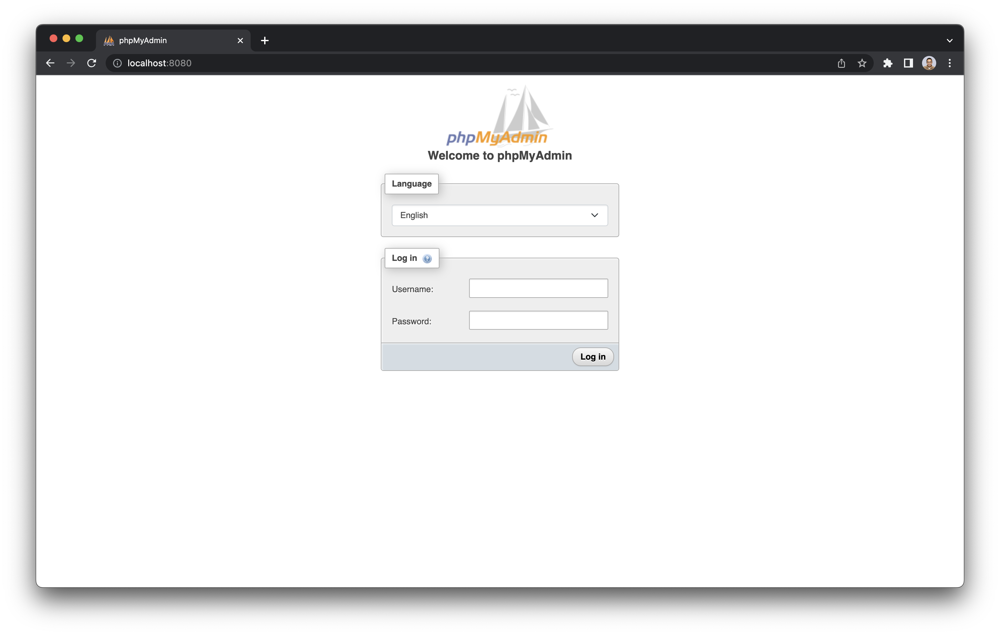

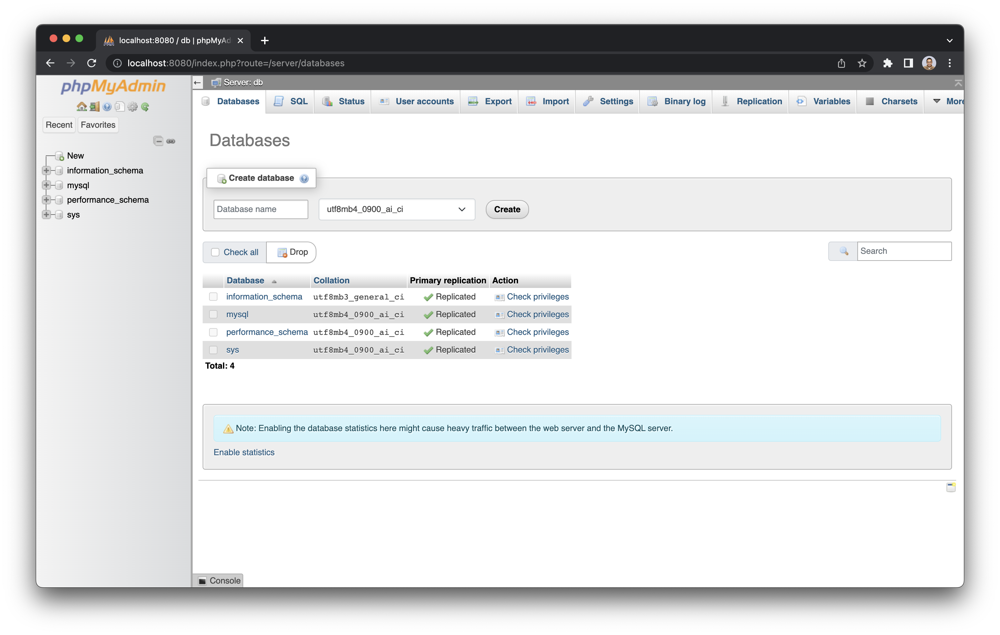

# Packaging into a docker compose file

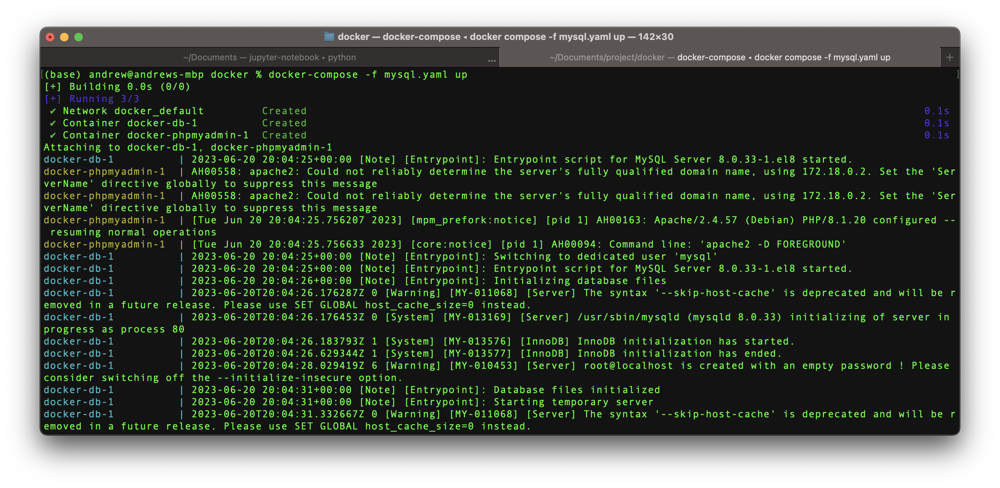

<a href="https://www.flaticon.com/free-icons/database" title="database icons">Database icons created by phatplus - Flaticon</a>

<a href="https://www.flaticon.com/free-icons/dashboard" title="dashboard icons">Dashboard icons created by Eucalyp - Flaticon</a>